# NLE Assessed Coursework 2: Question 2

For this assessment, you are expected to complete and submit 4 notebook files.  There is 1 notebook file for each question (to speed up load times).  This is notebook 2 out of 4.

Marking guidelines are provided as a separate document.

In order to provide unique datasets for analysis by different students, you must enter your candidate number in the following cell.

In [14]:
candidateno=181345 #this MUST be updated to your candidate number so that you get a unique data sample


In [15]:
#preliminary imports
import sys
sys.path.append(r'\\ad.susx.ac.uk\ITS\TeachingResources\Departments\Informatics\LanguageEngineering\resources')
sys.path.append(r'/Users/juliewe/Documents/teaching/NLE2018/resources')
sys.path.append(r'/Users/lucaskoh/Documents/NLE/resources')

import re
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from itertools import zip_longest
from sussex_nltk.corpus_readers import ReutersCorpusReader
import random
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
import math
import operator

def normalise(tokenlist):
    tokenlist=[token.lower() for token in tokenlist]
    tokenlist=["NUM" if token.isdigit() else token for token in tokenlist]
    tokenlist=["Nth" if (token.endswith(("nd","st","th")) and token[:-2].isdigit()) else token for token in tokenlist]
    tokenlist=["NUM" if re.search("^[+-]?[0-9]+\.[0-9]",token) else token for token in tokenlist]
    return tokenlist



## Question 2: Distributional Semantics (25 marks)


In [16]:
rcr = ReutersCorpusReader().finance()
rcr.enumerate_sents()

1113359

In [17]:
random.seed(candidateno)  
samplesize=2000
iterations =100
sentences=[]
for i in range(0,iterations):
    sentences+=[normalise(sent) for sent in rcr.sample_sents(samplesize=samplesize)]
    print("Completed {}%".format(i))
print("Completed 100%")

Completed 0%
Completed 1%
Completed 2%
Completed 3%
Completed 4%
Completed 5%
Completed 6%
Completed 7%
Completed 8%
Completed 9%
Completed 10%
Completed 11%
Completed 12%
Completed 13%
Completed 14%
Completed 15%
Completed 16%
Completed 17%
Completed 18%
Completed 19%
Completed 20%
Completed 21%
Completed 22%
Completed 23%
Completed 24%
Completed 25%
Completed 26%
Completed 27%
Completed 28%
Completed 29%
Completed 30%
Completed 31%
Completed 32%
Completed 33%
Completed 34%
Completed 35%
Completed 36%
Completed 37%
Completed 38%
Completed 39%
Completed 40%
Completed 41%
Completed 42%
Completed 43%
Completed 44%
Completed 45%
Completed 46%
Completed 47%
Completed 48%
Completed 49%
Completed 50%
Completed 51%
Completed 52%
Completed 53%
Completed 54%
Completed 55%
Completed 56%
Completed 57%
Completed 58%
Completed 59%
Completed 60%
Completed 61%
Completed 62%
Completed 63%
Completed 64%
Completed 65%
Completed 66%
Completed 67%
Completed 68%
Completed 69%
Completed 70%
Completed 71%
Co

In [18]:
def generate_features(sentences,window=1):
    mydict={}
    for sentence in sentences:
        for i,token in enumerate(sentence):
            current=mydict.get(token,{})
            features=sentence[max(0,i-window):i]+sentence[i+1:i+window+1]
            for feature in features:
                current[feature]=current.get(feature,0)+1
            mydict[token]=current
    return mydict

a) **Run** `generate_features(sentences[:5])`.  With reference to the code and the specific examples, **explain** how the output was generated. \[4 marks\]

In [19]:
generate_features(sentences[:5])

{'in': {'july': 1, 'rate': 1, 'the': 2, 'pace': 1, 'advantage': 1, 'a': 1},
 'july': {'in': 1, 'NUM': 1},
 'NUM': {'july': 1, ',': 2, 'a': 1, 'pct': 1, 'dist': 1},
 ',': {'NUM': 2, 'irs': 1, 'competitors': 1, 'but': 1, 's.c.': 1},
 'irs': {',': 1, 'announced': 1},
 'announced': {'irs': 1, 'that': 1},
 'that': {'announced': 1,
  'municipalities': 1,
  'soir': 1,
  'one': 1,
  'but': 1,
  'for': 1},
 'municipalities': {'that': 1, 'can': 1},
 'can': {'municipalities': 1, 'avoid': 1},
 'avoid': {'can': 1, 'having': 1},
 'having': {'avoid': 1, 'bonds': 1},
 'bonds': {'having': 1, 'declared': 1},
 'declared': {'bonds': 1, 'taxable': 1},
 'taxable': {'declared': 1, 'by': 1},
 'by': {'taxable': 1, 'settling': 1},
 'settling': {'by': 1, 'any': 1},
 'any': {'settling': 1, 'overcharges': 1},
 'overcharges': {'any': 1, 'with': 1},
 'with': {'overcharges': 1, 'the': 1},
 'the': {'with': 1,
  'agency': 1,
  'u.s.': 1,
  'in': 2,
  'first': 1,
  'second': 1,
  'of': 2,
  'biggest': 1,
  'and': 1,
  '

## Code
The `generate_features()` method takes a *sentence data set* and a *window size* as parameters. The window size is set to 1 as default unless specified. The method generates feature values depending on the window size given. It does so by splitting the sentence data set to individual sentences and storing them as individual tokens in a dictionary. Furthermore, the **key** of the dictionary is the target word and the **value** is represented by a dictionary of each word depending on the window size proximity stored as the **key** and the window size as the **value**.
Hence, `generate_features(sentence[:5])` will return a nested dictionary where given 5 sentences from the text corpus, the outer dictionary will return each word from the corpus as the key and as its value a dictionary containing the co-occuring words given its window size as the value.

## Context
When going through a set of sentences, some words may constrain the meaning of the other words around them. For instance, given the part of the sentence *"Municipalities can **avoid** having bonds declared"* we are informed about the nature of a 'municipality' in which it is an entity that pertains to a financial type. Similarly, we are also informed that **bonds** are a type of entity which could be *avoided*. Hence, as we go through a set of sentences, we can learning all the instances which co-occurs as `facets of meaning`. 

### Features
Features generally capture these `facets of meaning` which is extracted from a corpus. In this case, the `generate_features()` method will check the proximity of the words and represent whether given the window size from the target word if co-occurence feartures exist. For instance, given the word **municipalities** and its window size 1, the words which co-occur $\pm 1$ from the target word **municipalities** the features added per target words are *that* and *can*. `'municipalities': {'that': 1, 'can': 1}`. 


b) Write code and **find** the 100 most frequently occurring words that
* are in your sample; AND
* have at least one noun sense according to WordNet
\[ 4 marks\]

In [20]:
from nltk.corpus import wordnet as wn

#This variable will extract the nouns from the synset. 
nouns_set = {x.name().split('.', 1)[0] for x in wn.all_synsets('n')}

#The method will iterate through the noun_set
#and the word has at least one noun sense according to WordNet
#then it would add it to a dictionary - mydict. 
def freq_dist(sentences):
    mydict={}
    for sentence in sentences:
        for token in sentence:
            if token in nouns_set:
                mydict[token]=mydict.get(token,0)+1
    return mydict

#returns the 100 most frequent elements in the dictionary. 
def most_frequent(freqdist,k=100):
    return sorted(freqdist.items(),key=operator.itemgetter(1),reverse=True)[:k]

most_frequent(freq_dist(sentences))

[('a', 49073),
 ('at', 14197),
 ('will', 11148),
 ('he', 11062),
 ('bank', 9528),
 ('million', 8728),
 ('year', 8642),
 ('are', 8606),
 ('may', 8386),
 ('government', 8229),
 ('billion', 7136),
 ('rate', 5617),
 ('tax', 5594),
 ('trade', 5535),
 ('budget', 4996),
 ('more', 4866),
 ('growth', 4671),
 ('last', 4584),
 ('first', 4482),
 ('central', 4321),
 ('market', 4075),
 ('price', 4068),
 ('over', 3991),
 ('june', 3936),
 ('newsroom', 3928),
 ('there', 3925),
 ('state', 3922),
 ('inflation', 3823),
 ('union', 3790),
 ('economy', 3427),
 ('no', 3419),
 ('rates', 3379),
 ('minister', 3376),
 ('one', 3314),
 ('currency', 3309),
 ('week', 3302),
 ('april', 3290),
 ('interest', 3285),
 ('i', 3220),
 ('can', 3185),
 ('two', 3166),
 ('deficit', 3123),
 ('finance', 3060),
 ('wednesday', 2712),
 ('european', 2686),
 ('tuesday', 2685),
 ('time', 2671),
 ('july', 2666),
 ('march', 2584),
 ('thursday', 2520),
 ('out', 2517),
 ('official', 2464),
 ('rise', 2444),
 ('current', 2416),
 ('change', 23

c) Write code to create distributional vector representations of each word in the corpus with a parameter to specify context window size.   \[5 marks \]

In [21]:
class word_vectors:
    def __init__(self,sentences,window=3):
        self.sentences=sentences
        self.window=window
        self.reps={}
        self.wordtotals={}
        self.feattotals={}
        self.generate_features()
        self.grandtotal=sum(self.wordtotals.values())
        self.convert_to_ppmi()
    
    def generate_features(self):
        for sentence in self.sentences:
            for i,token in enumerate(sentence):
                current=self.reps.get(token,{})
                features=sentence[max(0,i-self.window):i]+sentence[i+1:i+self.window+1]
                for feature in features:
                    current[feature]=current.get(feature,0)+1
                    self.feattotals[feature]=self.feattotals.get(feature,0)+1
                self.wordtotals[token]=self.wordtotals.get(token,0)+len(features)
                self.reps[token]=current

    def convert_to_ppmi(self):
        self.ppmi={word:{feat:max(0,math.log((freq*self.grandtotal)/(self.wordtotals[word]*self.feattotals[feat]),2)) for (feat,freq) in rep.items()} for (word,rep) in self.reps.items()}

In [22]:
wv = word_vectors(sentences)
wv.ppmi

{'in': {'july': 1.174698877525822,
  'NUM': 0.03836672682027088,
  ',': 0,
  'pct': 0,
  'annual': 0.73699675443596,
  'rate': 0,
  'the': 0.5291382785157591,
  'first': 1.6203236189983794,
  'three': 0.8502867570097011,
  '2-to-2-1/2': 3.177475368357759,
  'percent': 1.2218978072278466,
  'pace': 0.9617900490172945,
  'second': 2.014174683578323,
  'quarter': 2.349130427617288,
  'a': 0.6105389418313353,
  'competitive': 0,
  'advantage': 0,
  'number': 0.2952205054750223,
  'of': 0,
  'growth': 1.1539281743545284,
  'will': 0,
  'remain': 0.7392327402748449,
  'corridor': 0.7326905256848629,
  'largest': 0.5222144153107846,
  'stock': 0,
  'market': 0.6086829539638133,
  'world': 0.5745674933612976,
  'and': 0.08412851959424673,
  'have': 0,
  'weakened': 0.596525930143226,
  'recently': 0,
  'tandem': 2.8841164256671674,
  'with': 0.3940717861658914,
  '``': 0,
  'trade': 0.44297213191661394,
  'prospers': 3.4405097741915527,
  'presence': 2.144685433240089,
  'there': 0,
  'is': 0,

d) Plan and carry out an investigation into the correlation between semantic similarity according to the WordNet path similarity measure and distributional similarity with different context window sizes.  You should make sure that you include a graph of how correlation varies with context window size and that you discuss your results.  \[12 marks\]

In [23]:
#Calculates the dot product
def dot(wordA,wordB):
    the_sum=0
    for (key,value) in wordA.items():
        the_sum+=value*wordB.get(key,0)
    return the_sum

#Calculates the cosine similarity between two word vectors 
#returns the similarity value

def cos_sim(wordA,wordB):
    sim=dot(wordA,wordB)/(math.sqrt(dot(wordA,wordA)*dot(wordB,wordB)))
    return sim

#Calculates the WordNet similarity between two word vectors 
def word_net_similarity(wordA,wordB):
    similarity = 0
    for word_a in wn.synsets(wordA):
        for word_b in wn.synsets(wordB):
            if word_a.path_similarity(word_b) == None:
                similarity = 0
            elif word_a.path_similarity(word_b) > similarity: 
                similarity = word_a.path_similarity(word_b)
    return similarity

Text(0,0.5,'Correlation')

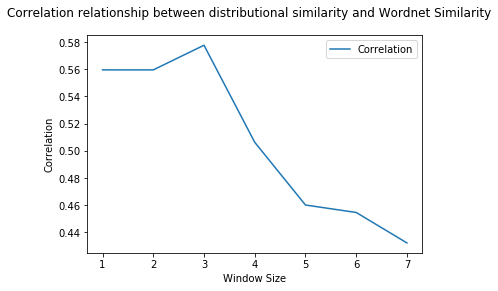

In [24]:
import string
import random
import re 
from nltk.corpus import stopwords 
from nltk.tokenize import word_tokenize 

s = 2000000
table_list = []
table_names = []
window_size = [1,2,3,4,5,6,7]
pairs = []
correlation_values = []

for n in range(0,len(window_size)):
    name_table = "data" + str(n)
    table_names += [name_table]

def dot(wordA,wordB):
    the_sum=0
    for (key,value) in wordA.items():
        the_sum+=value*wordB.get(key,0)
    return the_sum

def cos_sim(wordA,wordB):
    sim=dot(wordA,wordB)/(math.sqrt(dot(wordA,wordA)*dot(wordB,wordB)))
    return sim

def word_net_similarity(wordA,wordB):
    similarity = 0
    for word_a in wn.synsets(wordA):
        for word_b in wn.synsets(wordB):
            if word_a.path_similarity(word_b) == None:
                similarity = 0
            elif word_a.path_similarity(word_b) > similarity: 
                similarity = word_a.path_similarity(word_b)
    return similarity

#acquiring the filtered words from the tokenized  corpus.
wordList = []
stop_words = set(stopwords.words('english')) 
for sentence in sentences[:s]: 
    for word in sentence:
        if word not in string.punctuation and word != 'NUM' and word not in stop_words and not re.search("\d",word):
            wordList += [word]

#formulate the different pairs randomly.
for i in range (0,10):            
        wordA = wordList[random.randint(0,len(wordList)-1)]
        wordB = wordList[random.randint(0,len(wordList)-1)]          
        pairs += [(wordA,wordB)]

for x in range(0,len(window_size)):
    table_list = []
    for i in range (0,len(pairs)):            
        word1 = pairs[i][0]
        word2 = pairs[i][1]
        a_dict = {}
        b_dict = {}
        
        #accessing the individual features of each word pair
        #return the count feature of each word 
        word_dict = generate_features(sentences[:s],window_size[x])
        for key,val in word_dict.items():
            if key == word1:
                a_dict = val
            if key == word2:
                b_dict = val
        table_list += [[word1 + ' , ' + word2, cos_sim(a_dict,b_dict), word_net_similarity(word1,word2),window_size[x]]]
    table_names[x] = pd.DataFrame(table_list,columns = ['Word pairs','distributional similarity',
                                                        'WordNet path similarity','Window Size'])
    correlation_values += [(table_names[x]['distributional similarity'].corr(table_names[x]['WordNet path similarity']))]
plt.plot(window_size,correlation_values,label = "Correlation")
plt.legend()
plt.suptitle("Correlation relationship between distributional similarity and Wordnet Similarity")
plt.xlabel('Window Size')
plt.ylabel('Correlation')

*This investigation will discuss the methods and relationship between semantic similarity according to the WordNet path similarity measure and distributional similarity measure with different context window sizes.*


# Hypothesis : 
## The WordNet path similarity measure and distributional similarity measure are strongly correlated. 

## Semantics
Measuring semantic similarity and relatedness between terms is a quintessential problem in lexical semantics. The former is often defined as the close relationship between two words, for instance, the words `hot` and `cold` are centainly not synonyms but are certainly *similar words*. The latter representing the relationship of how words share a same semantic field, consider the words `football` and `player`, a football isn't similar to a player but they co-participate in the same events. This investigation will focus on the similarity asepct of semantics. 

## WordNet Path similarity Measure 
The WordNet based method utlizes synsets which are groups of nouns, verbs, adjectives, and adverbs from a lexical english database. Synsets are also respectively interlinked with lexical relations sich as hypernymy, meronymy, hyponymy and causality. Furthermore, one major use of the Wordnet Path similarity is to determine the meaning of a word from its given context, considering the sentence: **Elizabeth wanted food, so she made a pizza.**, Wordnet Path method might help a machine to understand the meaning of the sentence. For instance, it will be able to indentify that `pizza` is a type of meal by recognizing the superordinate/hyponym `food` it would understand that `pizza` is the hypernym of `food`. 

## Distributional Similarity Measure
An essential assumption of distributiuonal similarity hypothesis is that words that occur in similar contexts in a large text corpus also have similar or relevant semantics (Gentner 1982). There are different ways of calculating simililarity between two word vectors such as Jaccard's measure and Cosine similarity. This investigation utlizes the latter. The cosine measure returns the cosine angle between the vectors and is calculated as the dot product of the vectors: $$cos(n_1,n_2) = \frac{\sum_vP(v|n_1)*(P(v|n_2))}{\sqrt{\sum_vP(v|n_1)^2\sum _vP(v|n_2)^2)}}$$ (Weeds,2003)

If the angle between the two vectors is 0, this signifies a that there is no similarity between the two vector of words. Whereas, if the angle is 1, the two vectors are identical distributions.

## Implementation
### Wordnet Path 
The `word_net_similarity()` method takes in a **wordA** and a **wordB** as parameters. It will go through every synset of **wordA** and **wordB**, if **wordA**'s synset linked to **wordB**'s synset is None then the similarity is 0, otherwise, it will return the wordnet similarity value in `similarity`. 
### Distributional paradigm
The `distributional similarity` was calculated using the *cosine similarity*. The design was based upon the *bag-of-words* approach: For each word `w` in the dataset corpora, we will collect every term `t` that appears in a window centered in `w`, and add them to the vector together with its frequency. This was facilitated by using the `generate_features()` method. 

## Graphs & Correlation
### Correlation coefficient
Two random values are considered to be positively correlated if a high value in one would lead to a high value in the other, and consequently, a low value in one would result in the a low value in the other.(Weeds,2003)
Furthermore, if one value does not affect the other value we can conclude the two values either have poor correlation or none at all. The major correlation calculations between the distributional similarity values and the WordNet similarity values where carried out by utilizing **pandas.DataFrame.corr**. 
## Graphs
In order to envisage the main hypothesis that the WordNet path similarity measure and distributional similarity measure are strongly correlated given two random words vectors, we can plot a linear graph where the `x-axis` represents the **window size** and the `y-axis` represents the correlation value. 

## Observations
Before plotting the graph to check if there was an existing pattern the `window size` values were constant `c` for different pair sizes. `c` = [1,2,3,4,5,6,7]

The graph `Correlation relationship between distributional similarity and Wordnet Similarity` below was plotted with a sentence size 200000, size of the pairs being 500 and `c` 
 <img src="graph500p.png"> 
Although towards the end of the curve, there is a slight delcinem, we can observe an overall upward trend of the correlation value as the window size increases. Hence a strong correlation between the window size and the correlation value between the distributional similarity and wordnet similarity value between pairs of words is present. 

However, in order to discuss further of how each value affects the other it is necessary to plot a different graph altering the value sets. This time the number of pairs is changed to 5 to observe the affects of the correlation values if we decrease the pair size.

<img src="graph5.png" alt="Drawing" style="width: 550px;"/>
As shown in the graph above, we can observe that as we decrease the pair size of the parameters, the curve displays a downward trending behaviour which is associated with a negative correlation. 

## Conclusion
The hypothesis stated at the beginning of the investigation was: The WordNet path similarity measure and distributional similarity measure are strongly correlated. From our observation we may conclude the following:

* As the window size increases, the distributional similarity value increases but the WordNet similarity value remains constant. This can shown in the following table of the data values below: 
<img src="1.png" alt="Drawing" style="width: 450px;"/>
<img src="5.png" alt="Drawing" style="width: 450px;"/>

* Therefore, the distributional similarity is strongly correlated with the window size whereas the WordNet similarity value remains constant. 

* When context size increases, the distributional similarity value would also increases following the assumption stated earlier that words occuring in a similar context in a text large corpus would also have similar or related sentences. Hence, more words will be considered when the context windoe size increases increasing the overall similarity and correlation. 

* We observed also that as we decreased the pair size, the correlation decreased. This may be attributed to the lack of testing data being passsed. 

* The WordNet similarity value reamins constant as the synset is not affected by the context window size. 

**Therefore, although the distributional similarity is strongly correlated with windowsize, the WordNet similarity value remains constant**

## Limitations 
The windowsize could have been manipulated further to demonstrate whether it created any variance in the final correlation data. The running time of the algorithm being larger than $n^3$ prevented testing on larger pair sizes. Furthermore, as the pairs were generated randomly, there may have been outliers in the data which produced inaccurate representation of the correlation. 

http://citeseerx.ist.psu.edu/viewdoc/download?doi=10.1.1.10.538&rep=rep1&type=pdf - (Weeds,2003)